## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

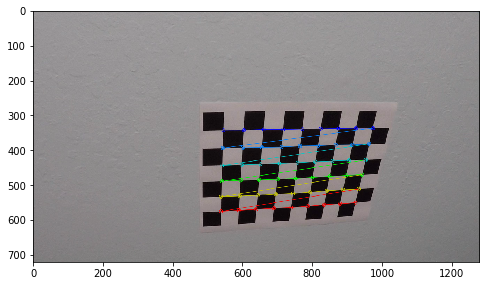

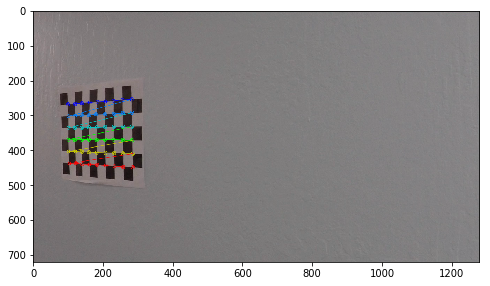

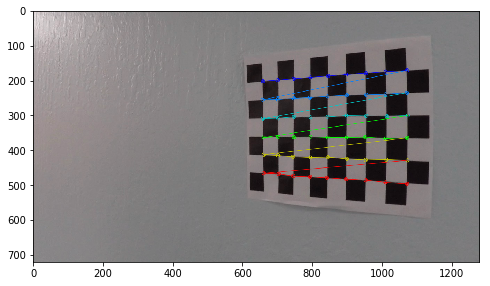

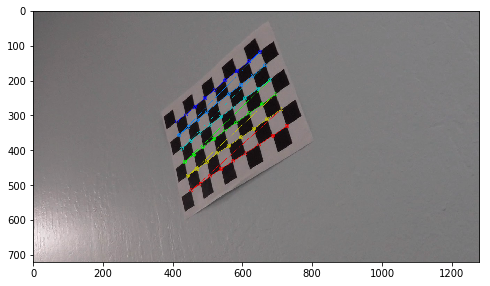

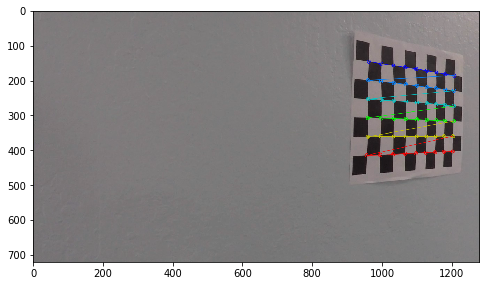

...

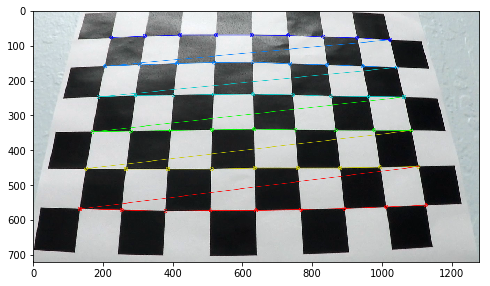

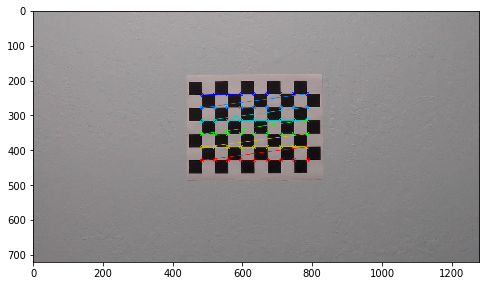

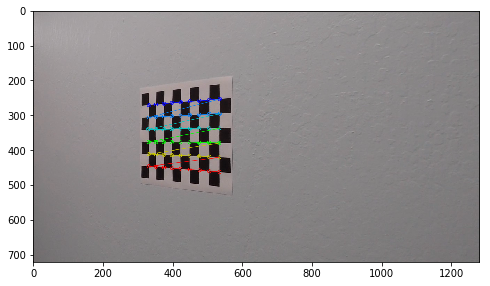

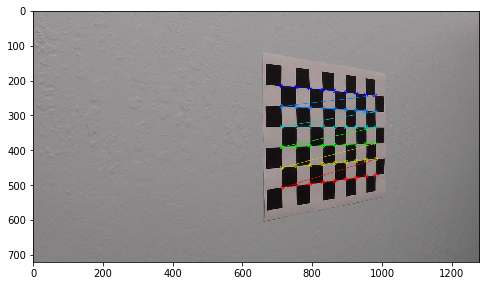

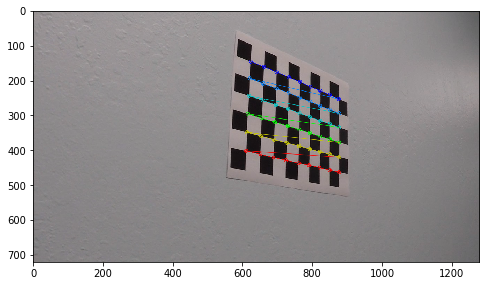

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib inline

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
       
        plt.figure(figsize=(8,8))
        plt.imshow(img)

# With all the calibration images we performed the calibration of the camera
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)


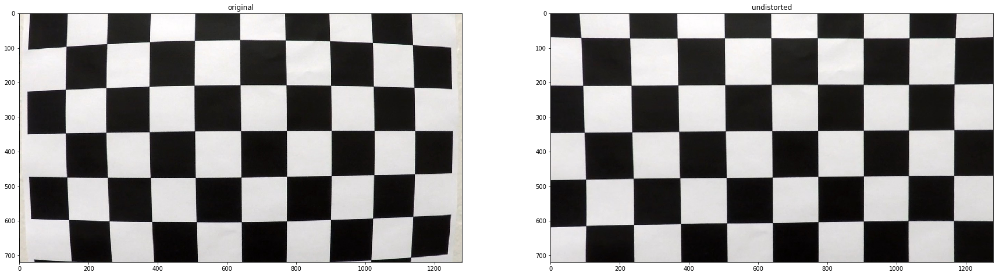

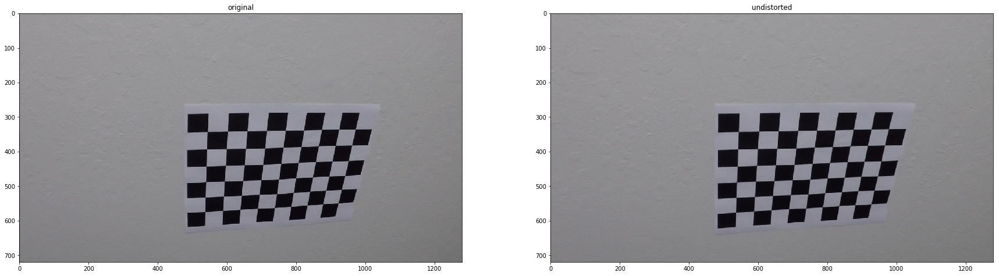

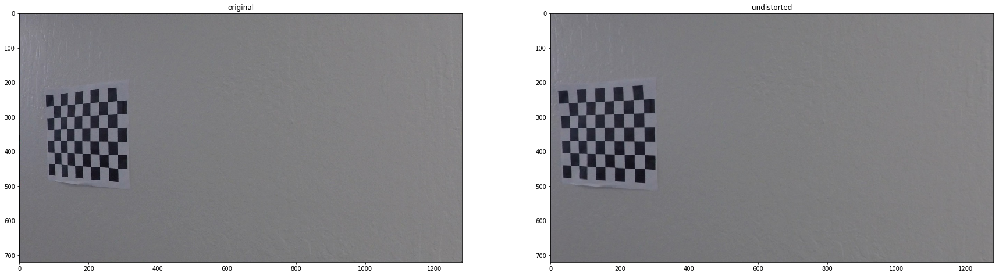

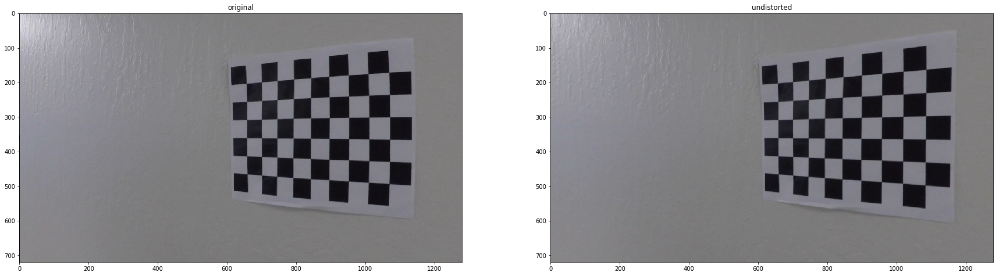

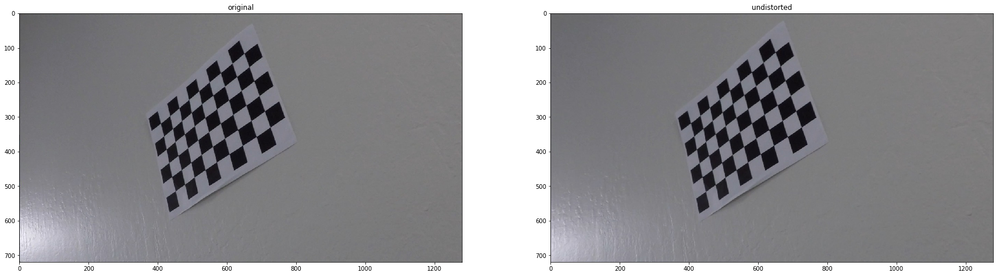

...

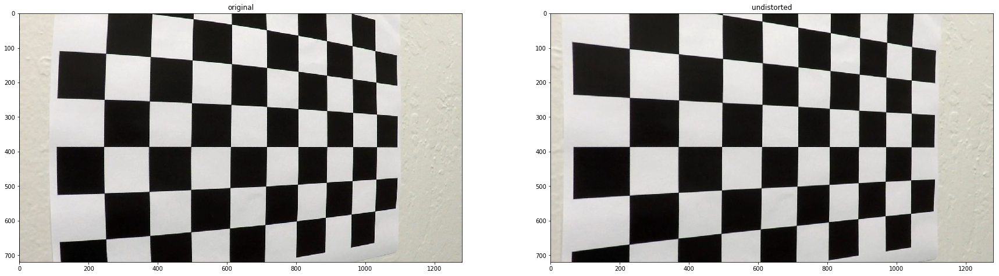

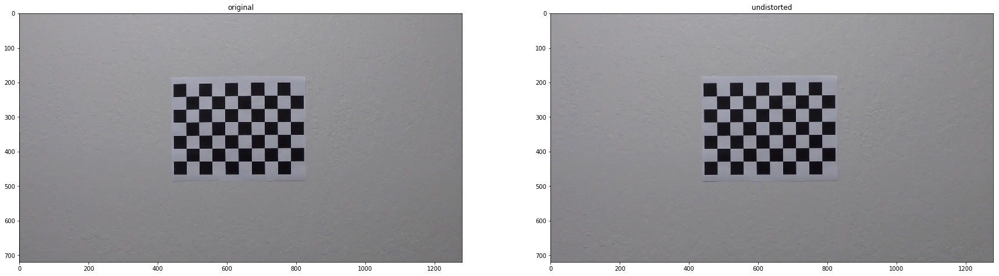

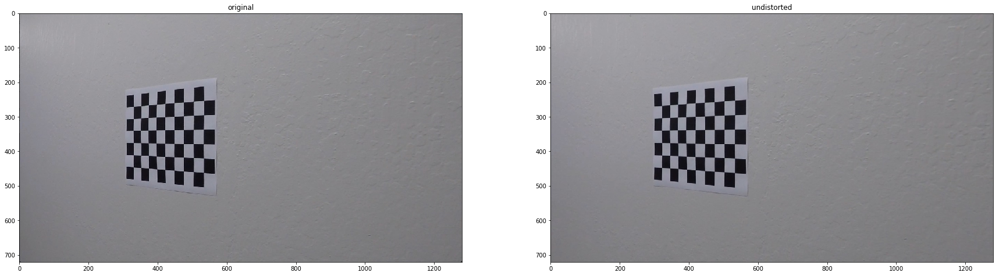

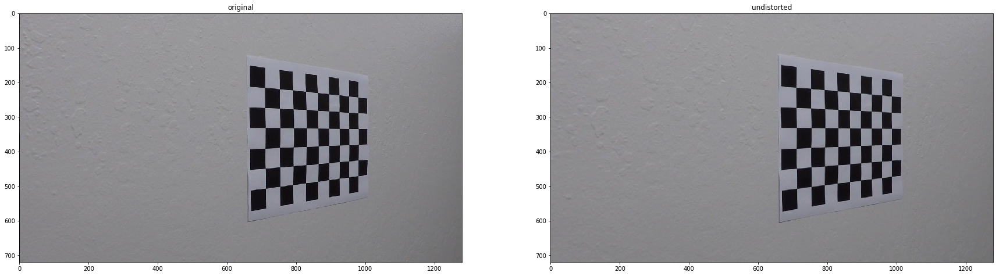

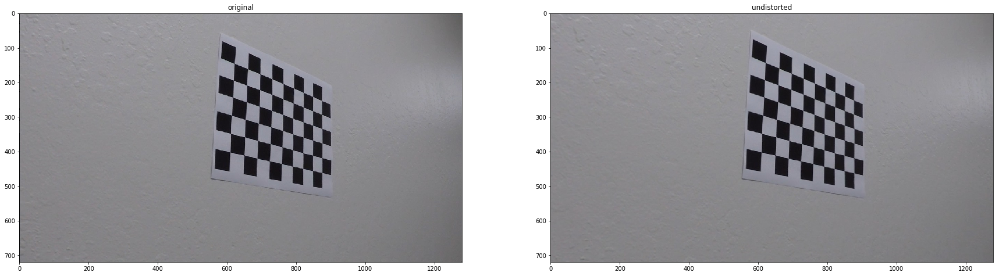

In [2]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib inline

# Compare the original calibration images with themselves once undistorted  
for fname in images:
    img = cv2.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    img = img[:,:,::-1]
    dst = dst[:,:,::-1]
    plt.figure(figsize=(30,20))
    plt.subplot(121)
    plt.title('original')
    plt.imshow(img)
    plt.subplot(122)
    plt.title('undistorted')
    plt.imshow(dst)
    plt.show()
   

## Apply distorsion correction to raw images

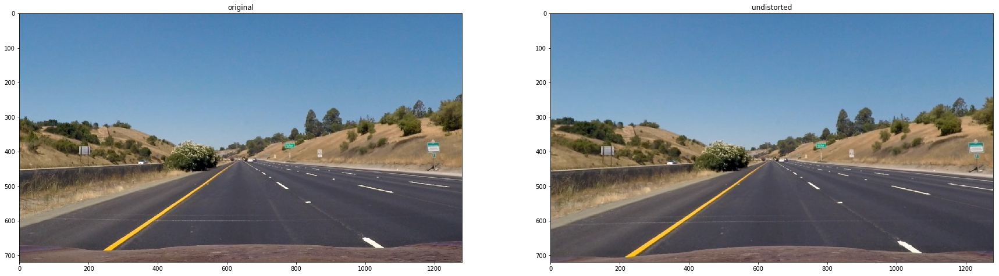

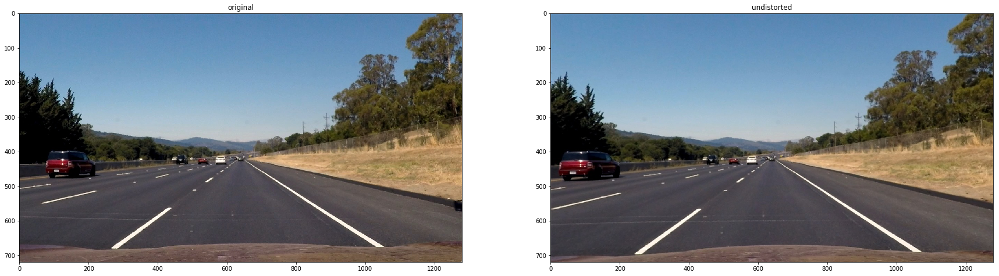

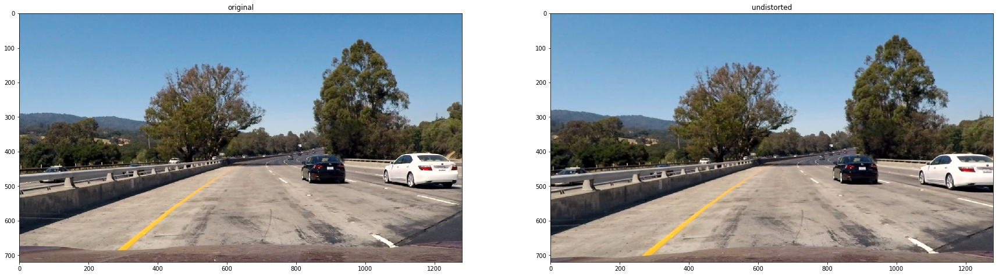

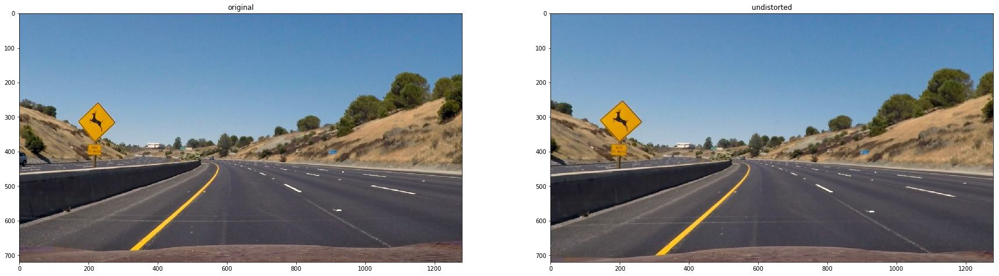

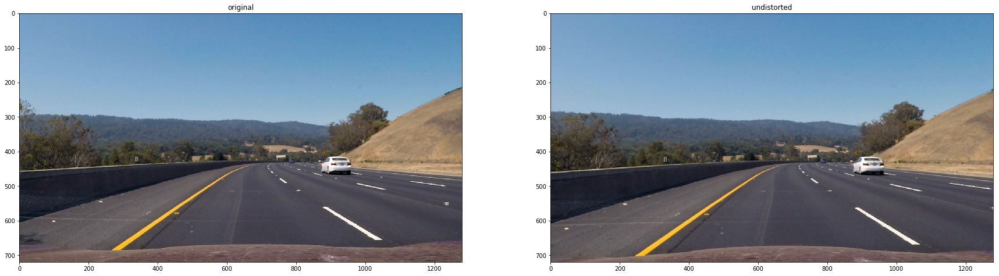

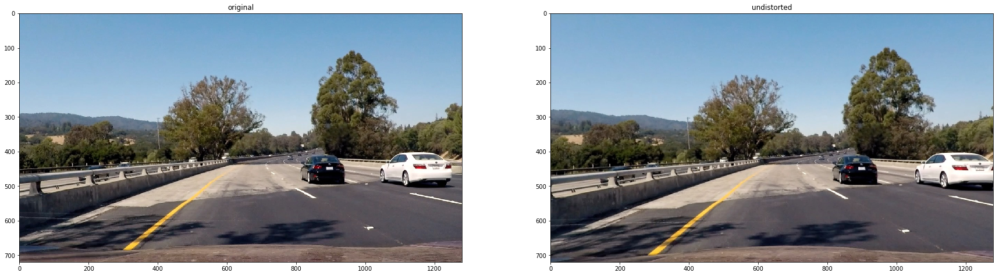

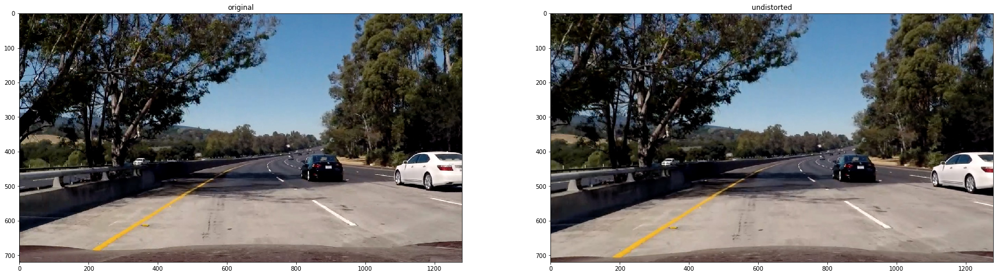

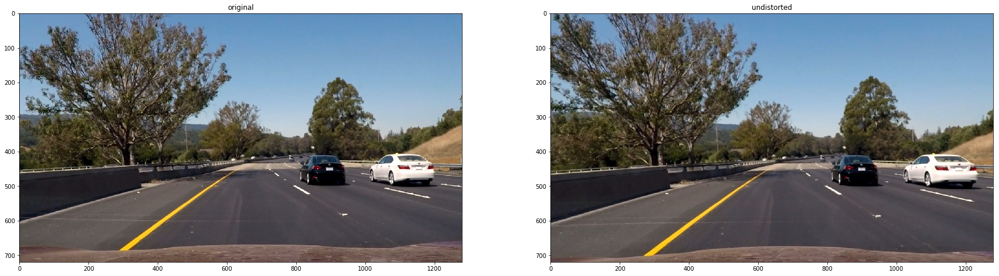

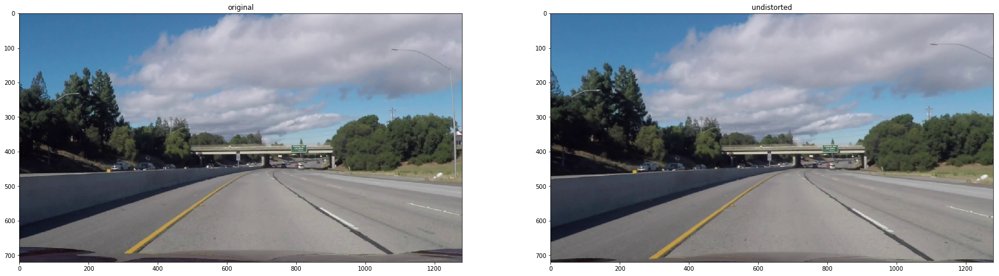

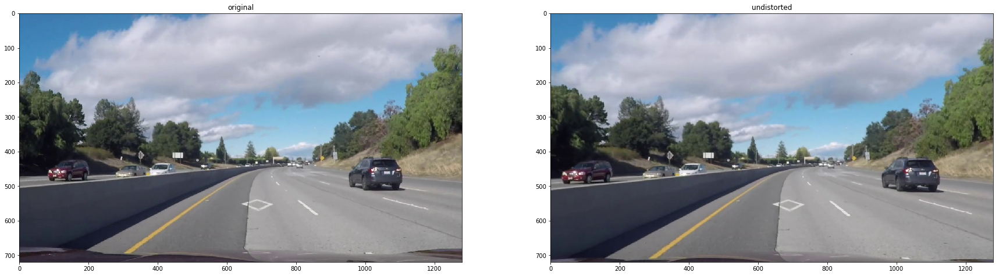

In [3]:
# Apply the calibration matrix to the test images

test_images = glob.glob('./test_images/*.jpg')

undistorted_images = []

# Compare the original calibration images with themselves once undistorted  
for fname in test_images:
    img = cv2.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    undistorted_images.append(dst)
    img = img[:,:,::-1]
    dst = dst[:,:,::-1]
    plt.figure(figsize=(30,20))
    plt.subplot(121)
    plt.title('original')
    plt.imshow(img)
    plt.subplot(122)
    plt.title('undistorted')
    plt.imshow(dst)
    plt.show()


## Thresholded binary images

In [4]:
def thresholdImage(img, show=False):
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    s_channel = hsv[:,:,2]
    h_channel = hsv[:,:,0]
    
    # gradient x
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    thresh_min = 15
    thresh_max = 130
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
      
    # threshold color channel h
    h_thresh_min = 95 #95
    h_thresh_max = 115 #115
    h_binary = np.zeros_like(h_channel)
    h_binary[(h_channel >= h_thresh_min) & (h_channel <= h_thresh_max)] = 1
        
    #v_thresh_min = 15 #15
    #v_thresh_max = 100 #120
    #sobelv = cv2.Sobel(v_channel, cv2.CV_64F, 1, 0)
    #abs_sobelv = np.absolute(sobelv) # Absolute x derivative to accentuate lines away from horizontal
    #scaled_sobelv = np.uint8(255*abs_sobelv/np.max(abs_sobelv))
    #v_binary = np.zeros_like(v_channel)
    #v_binary[(scaled_sobelv >= v_thresh_min) & (scaled_sobelv <= v_thresh_max)] = 1
    
    # threshold color channel s
    #s_thresh_min = 170 #160
    #s_thresh_max = 255
    #s_binary = np.zeros_like(s_channel)
    #s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1
    
    s_thresh_min = 15 #15
    s_thresh_max = 130 #120
    sobels = cv2.Sobel(s_channel, cv2.CV_64F, 1, 0)
    abs_sobels = np.absolute(sobels) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobels = np.uint8(255*abs_sobels/np.max(abs_sobels))
    s_binary = np.zeros_like(s_channel)
    s_binary[(scaled_sobels >= s_thresh_min) & (scaled_sobels <= s_thresh_max)] = 1
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[((s_binary == 1) | (sxbinary == 1)) & (h_binary == 1)] = 1
    binary_images.append(combined_binary)
    
    color_binary = np.dstack((h_binary, sxbinary, s_binary))
    
    if show:
        img = img[:,:,::-1]
        plt.figure(figsize=(30,20))
        plt.subplot(131)
        plt.imshow(img)
        plt.subplot(132)
        plt.title('Stacked thresholds')
        plt.imshow(color_binary)
        plt.subplot(133)
        plt.title('Combined S channel and Gradient thresholds')
        plt.imshow(combined_binary,cmap='gray')
        plt.show()
        
    return combined_binary

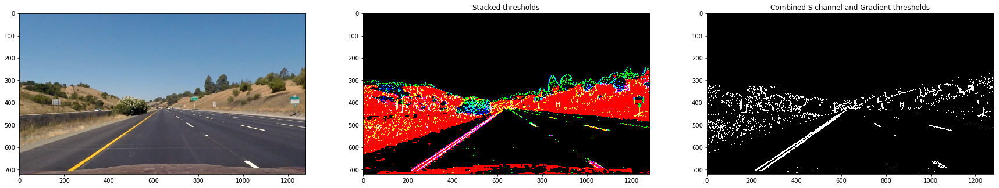

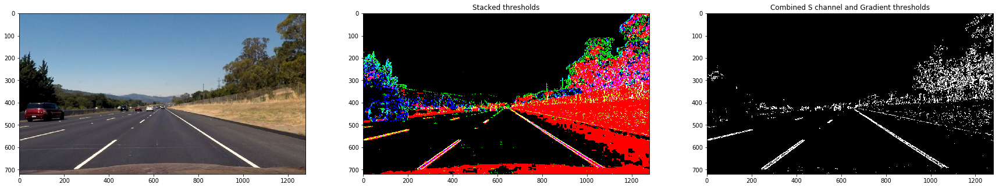

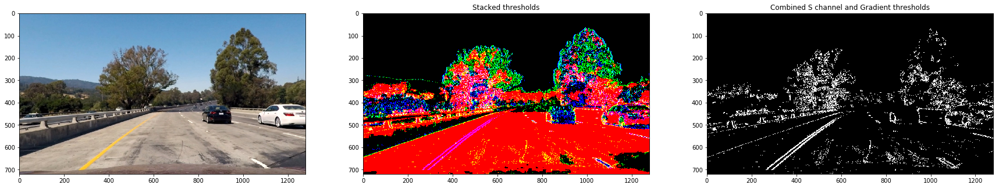

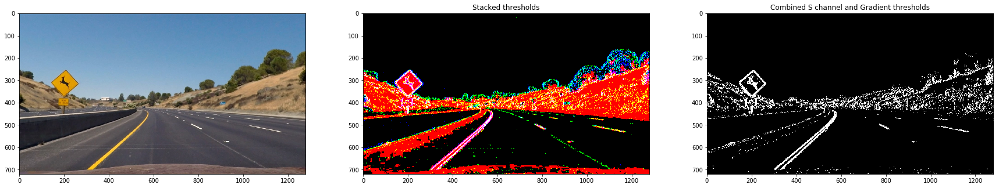

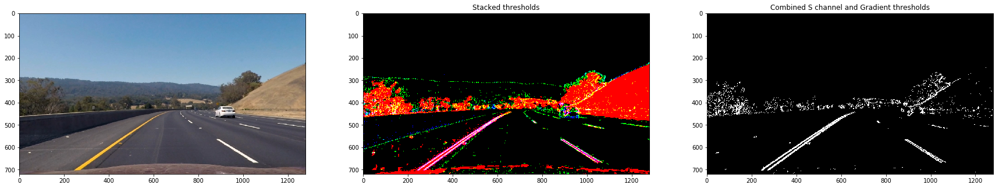

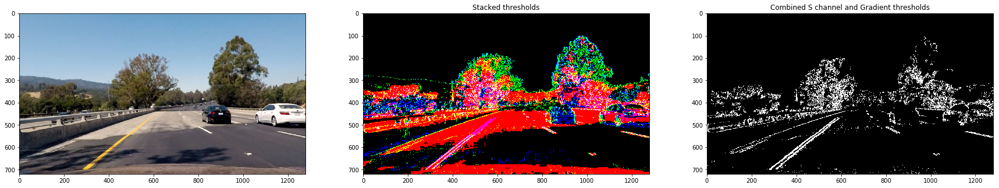

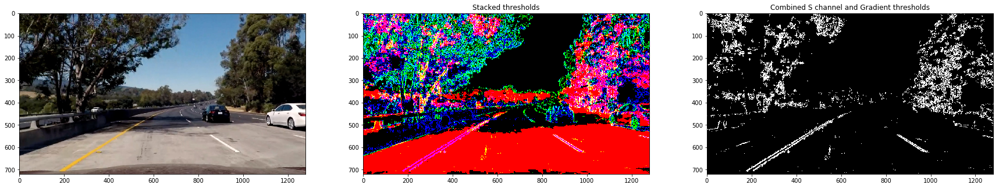

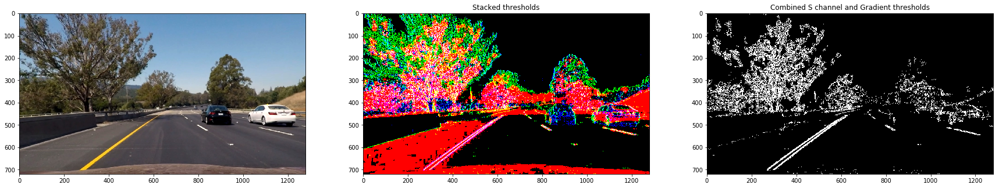

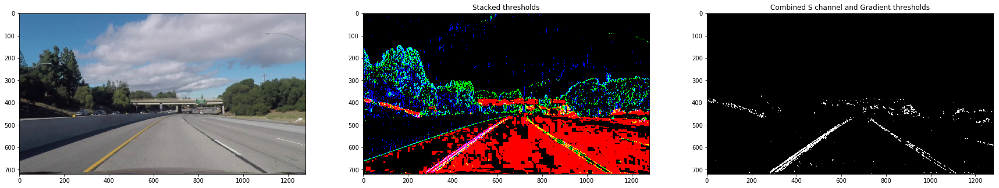

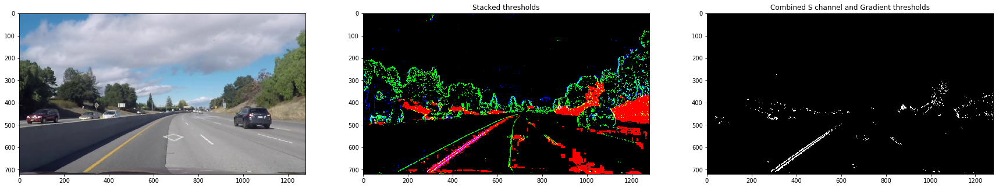

In [5]:
binary_images = []

for img in undistorted_images:
    color_binary = thresholdImage(img,True)
    

## Birds-eye view

In [6]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

src = np.float32( [[583,460], [207,binary_images[0].shape[0]], [1100,binary_images[0].shape[0]],[698,460]])
dst = np.float32( [[327,0], [327,binary_images[0].shape[0]], [980,binary_images[0].shape[0]],[980,0]])

def warper(img):
    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image

    return warped

def unwarper(img):
    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image

    return warped



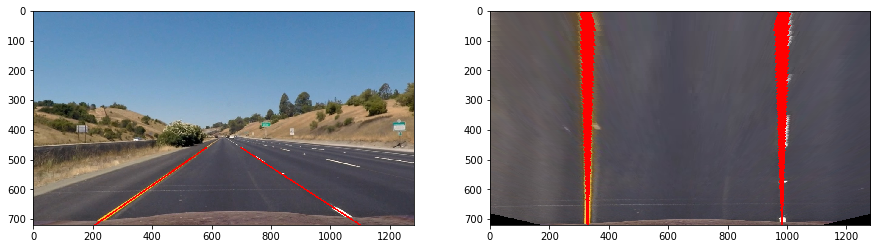

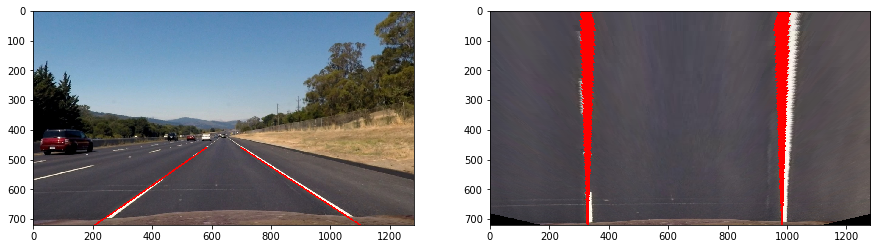

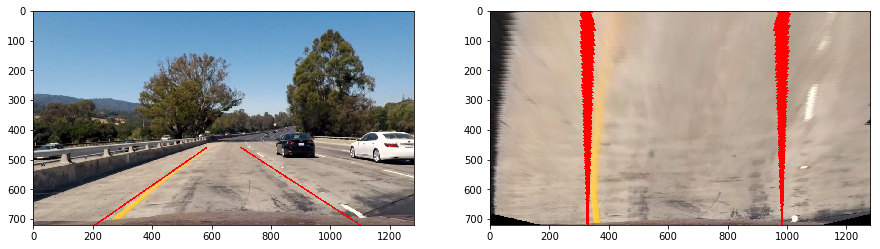

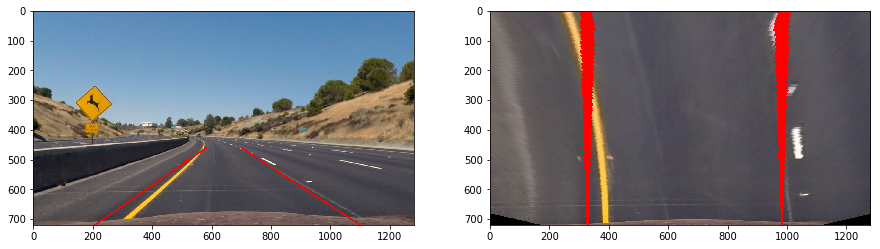

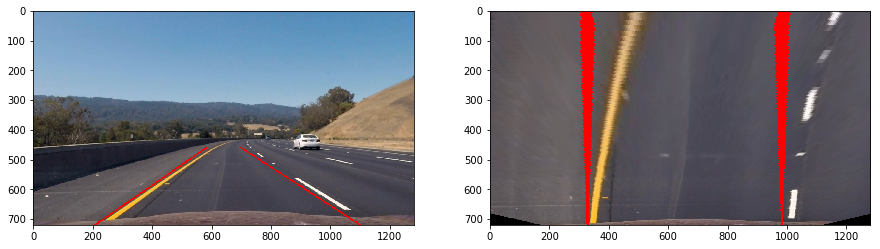

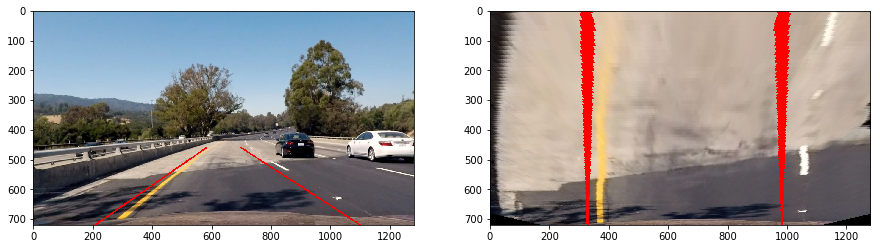

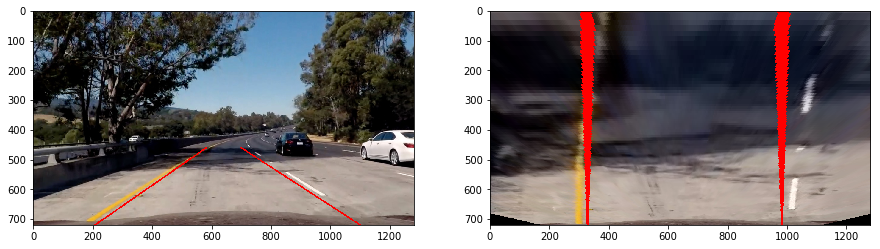

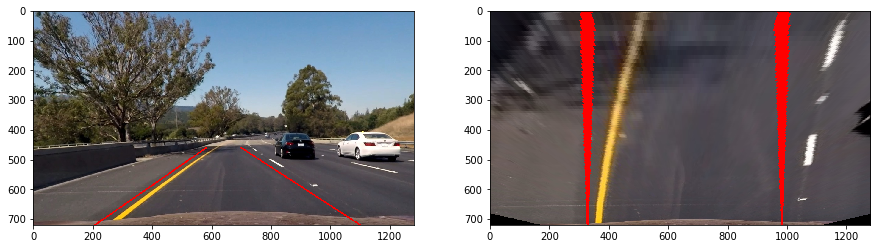

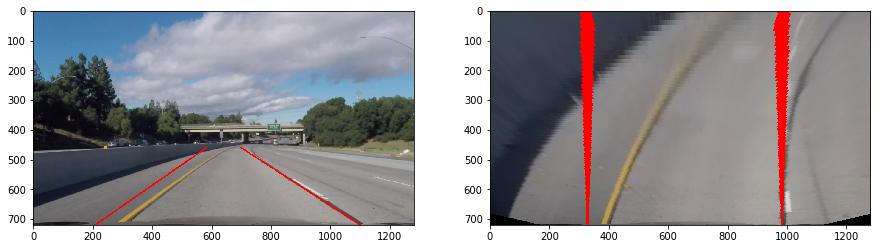

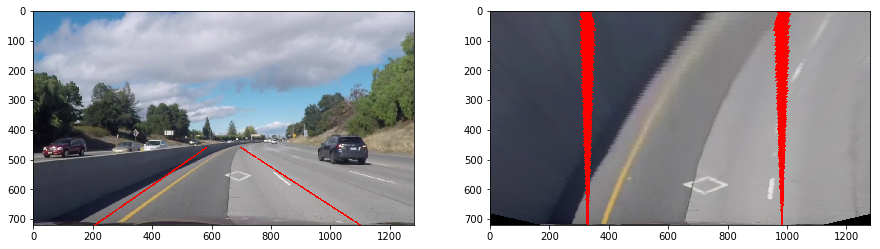

In [7]:
for image in undistorted_images:
    img = image.copy()
    cv2.line(img,(src[0][0],src[0][1]),(src[1][0],src[1][1]),(0,0,255),thickness=3)
    cv2.line(img,(src[2][0],src[2][1]),(src[3][0],src[3][1]),(0,0,255),thickness=3)
    warped_image = warper(img)
    warped_image = warped_image[:,:,::-1]
    img = img[:,:,::-1]
    plt.figure(figsize=(15,15))
    plt.subplot(121)
    plt.imshow(img)
    plt.subplot(122)
    plt.imshow(warped_image)
    plt.show()


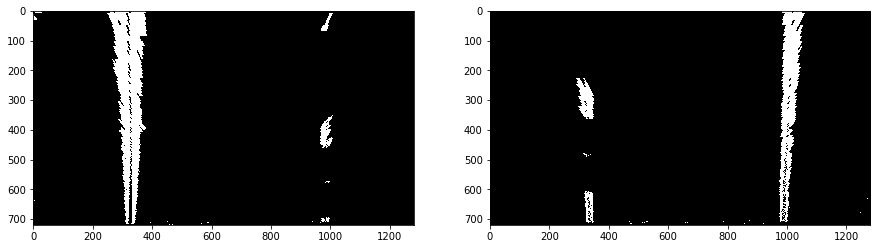

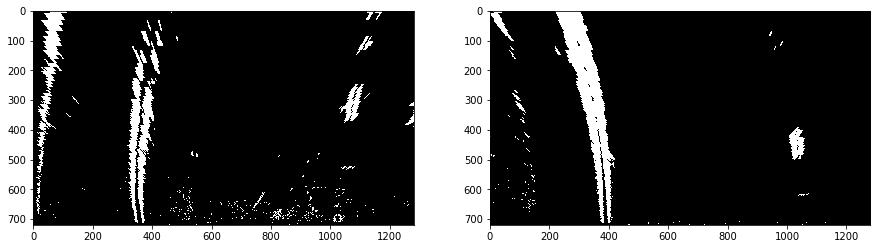

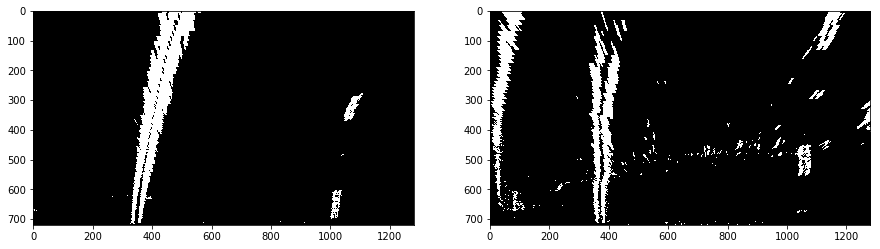

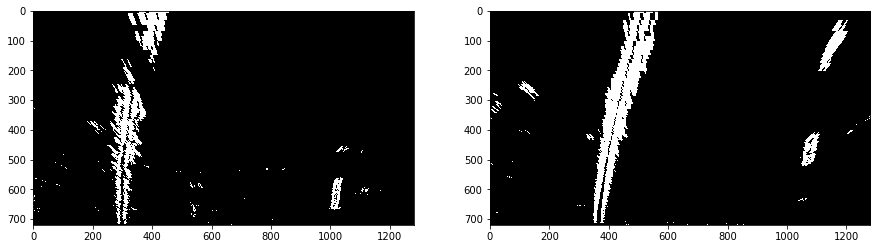

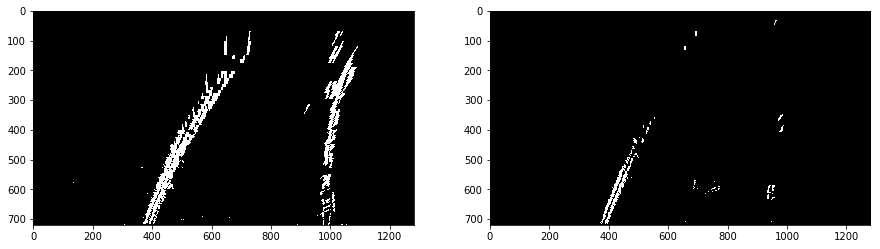

In [8]:
warped_images = []

for i in range(0,len(binary_images),2):
    warped_image1 = warper(binary_images[i])
    warped_images.append(warped_image1)
    plt.figure(figsize=(15,15))
    plt.subplot(121)
    plt.imshow(warped_image1, cmap='gray')
    if (i+1) <= (len(binary_images)-1): 
        warped_image2 = warper(binary_images[i+1])
        warped_images.append(warped_image2)
        plt.subplot(122)
        plt.imshow(warped_image2, cmap='gray')
  
    plt.show()
   

## Detect lane pixels and fit to find the lane boundary and show curvature, width and car position

In [9]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

class Lines(object):
    def __init__(self):
        self.left_fit = None 
        self.right_fit = None
        self.left_fitx = None
        self.right_fitx = None
        self.rightx = None
        self.leftx = None
        self.lefty = None
        self.righty = None
        self.out_img = None
        self.left_curverad = 0 
        self.right_curverad = 0
        self.car_position = 0
        self.width_lane = 0
        self.flg = False


def drawLineBoundaries(binary_warped, lastFrame, show=False):
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/653 # meters per pixel in x dimension
    
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    
    # Take a histogram of the bottom two-thirds the image 
    histogram = np.sum(binary_warped[binary_warped.shape[0]//3:,:], axis=0)
    # Find the peak of the left and right halves of the histogram 
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
   
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window  
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

     # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
     
    if lastFrame.flg == False:
        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin 
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            if show:
                # Draw the windows on the visualization image
                cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
                cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
            # Identify the nonzero pixels in x and y within the window 
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
           
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
           
            if len(good_right_inds) > minpix:
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
          
           
        # Concatenate the arrays of indices
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    else:
        left_fit = lastFrame.left_fit
        right_fit = lastFrame.right_fit
        left_fitx = lastFrame.left_fitx
        right_fitx = lastFrame.right_fitx
        left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
        right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  
        if show:
            window_img = np.zeros_like(out_img)
          
            # Generate a polygon to illustrate the search window area
            # And recast the x and y points into usable format for cv2.fillPoly()
            left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
            left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
            left_line_pts = np.hstack((left_line_window1, left_line_window2))
            right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
            right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
            right_line_pts = np.hstack((right_line_window1, right_line_window2))

            # Draw the lane onto the warped blank image
            cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0)) 
            cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
            out_img = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
            
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    if len(lefty) == 0 or len(leftx) == 0:
        lefty = lastFrame.lefty
        leftx = lastFrame.leftx
  
        
    if len(righty) == 0 or len(rightx) == 0 :
        rightx = lastFrame.rightx
        righty = lastFrame.righty
    
    left_fit = np.polyfit(lefty, leftx, 2)       
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    out_img2 = np.zeros_like(out_img)
    out_img2[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img2[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
   
    # Show the intermediate steps
    if show:
        plt.figure(figsize=(10,10))
        plt.imshow(out_img)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, out_img.shape[1])
        plt.ylim(out_img.shape[0], 0)
        plt.show()
            
        
    # Fit new polynomials to x,y in world space
    y_eval = np.max(ploty)
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Now our radius of curvature is in meters
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Calculate the width of the lane and the car position with respect the center
    width_lane = np.mean(right_fitx-left_fitx)*xm_per_pix;
    center_lane =  ((right_fitx[out_img.shape[0]-1]+left_fitx[out_img.shape[0]-1])/2)
    car_position = (center_lane - out_img.shape[1]/2)*xm_per_pix
    
    # Sanity check
    error = 0
    if lastFrame.flg == True: 
        if (abs(width_lane-lastFrame.width_lane)/lastFrame.width_lane) > 0.15:
            error = 1
        if abs(car_position-lastFrame.car_position) > 1:
            error = 1
        if abs(right_curverad/left_curverad) < 0.5:
            error = 1    
        if abs(left_curverad/right_curverad) < 0.5:
            error = 1
            
    if error == 0:
        lastFrame.left_fit = left_fit
        lastFrame.right_fit = right_fit
        lastFrame.left_fitx = left_fitx
        lastFrame.right_fitx = right_fitx
        lastFrame.lefty = lefty
        lastFrame.righty = righty
        lastFrame.leftx = leftx
        lastFrame.rightx = rightx
        lastFrame.out_img = out_img2
        lastFrame.left_curverad = left_curverad
        lastFrame.right_curverad = right_curverad
        lastFrame.car_position = car_position
        lastFrame.width_lane = width_lane
        lastFrame.flg = True
   
            
    return out_img
 
    

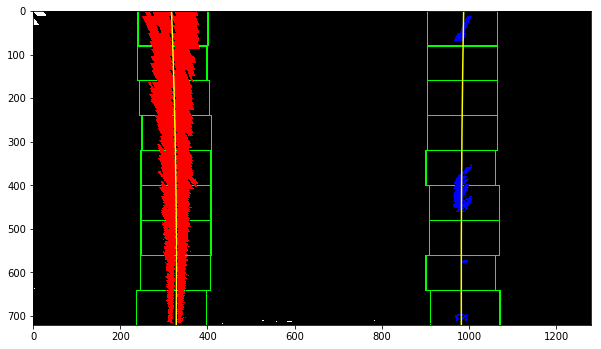

Left curvature:  4888.44 m
right curvature:  10648.47 m
Car position:  0.09 m
Lane width:  3.73 m


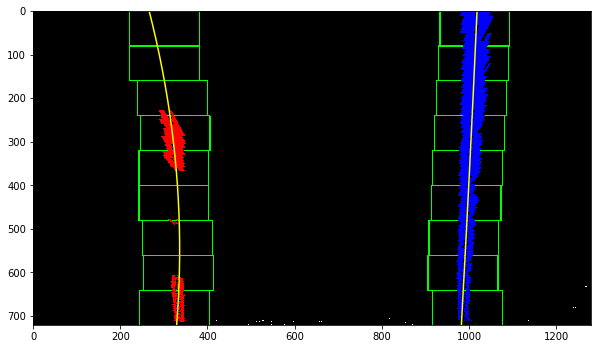

Left curvature:  658.30 m
right curvature:  21119.44 m
Car position:  0.09 m
Lane width:  3.87 m


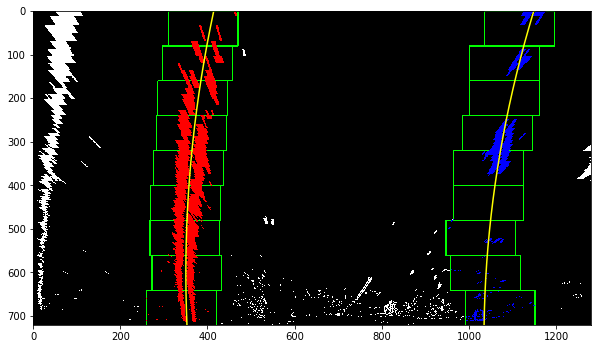

Left curvature:  864.48 m
right curvature:  762.32 m
Car position:  0.30 m
Lane width:  4.00 m


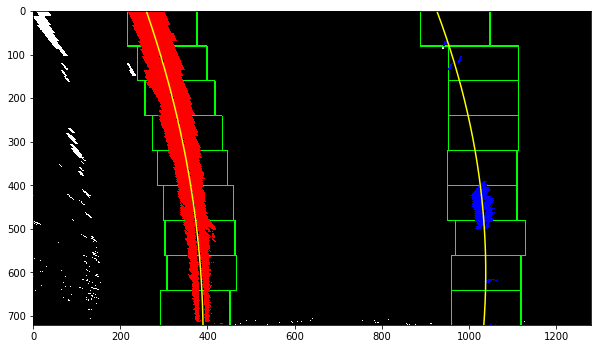

Left curvature:  665.36 m
right curvature:  492.80 m
Car position:  0.41 m
Lane width:  3.75 m


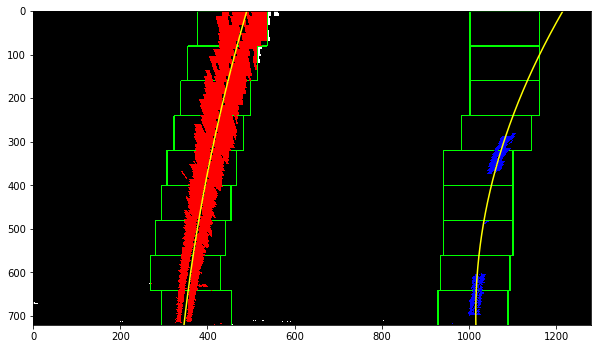

Left curvature:  1253.52 m
right curvature:  369.10 m
Car position:  0.23 m
Lane width:  3.81 m


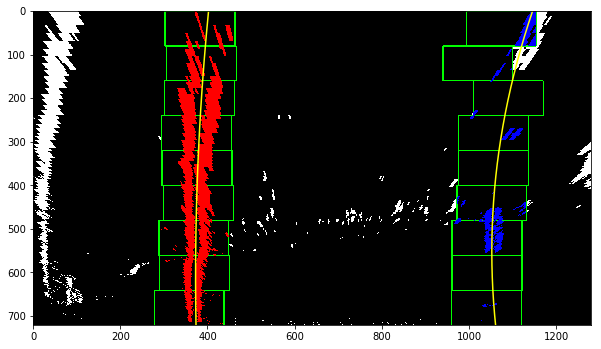

Left curvature:  1914.78 m
right curvature:  499.56 m
Car position:  0.44 m
Lane width:  3.94 m


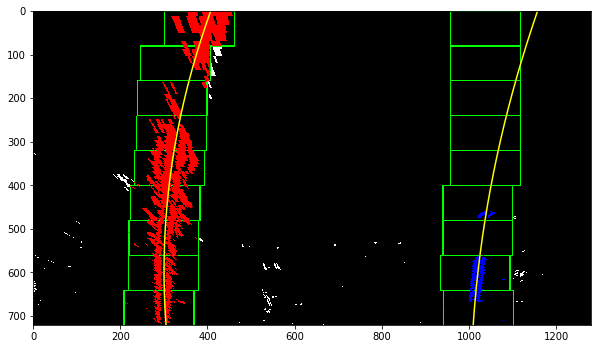

Left curvature:  509.28 m
right curvature:  795.95 m
Car position:  0.10 m
Lane width:  4.17 m


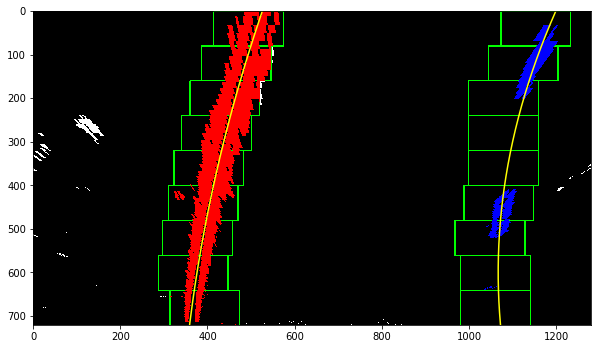

Left curvature:  1014.03 m
right curvature:  416.90 m
Car position:  0.43 m
Lane width:  3.82 m


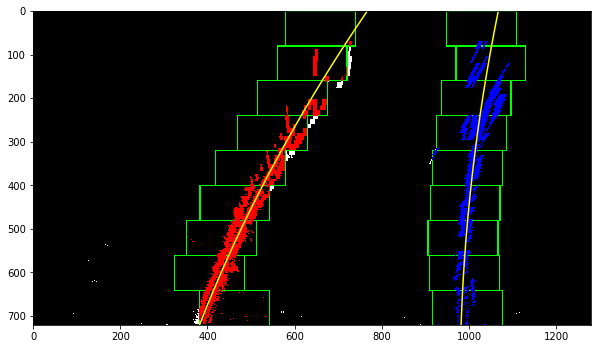

Left curvature:  758.12 m
right curvature:  1304.35 m
Car position:  0.24 m
Lane width:  2.59 m


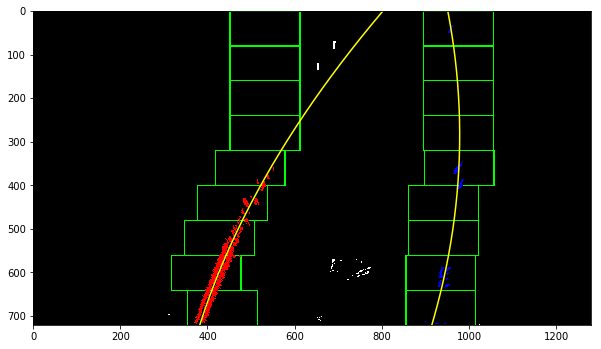

Left curvature:  418.46 m
right curvature:  455.86 m
Car position:  0.05 m
Lane width:  2.27 m


In [10]:
lastFrame = Lines()
for img in warped_images:
    lastFrame.flg = False
    drawLineBoundaries(img,lastFrame,True)
    print('Left curvature: ',"{0:.2f}".format(lastFrame.left_curverad) , 'm')
    print('right curvature: ',"{0:.2f}".format(lastFrame.right_curverad), 'm')
    print('Car position: ',"{0:.2f}".format(lastFrame.car_position), 'm')
    print('Lane width: ',"{0:.2f}".format(lastFrame.width_lane), 'm')


## Warp the detected lane boundaries back onto the original image

In [11]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

def addPoligonToImage(img, lastFrame):
    # Create an image to draw the lines on
    color_warp = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([lastFrame.left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([lastFrame.right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    linesImage = unwarper(lastFrame.out_img)
    result = cv2.addWeighted(img, 1, linesImage, 1, 0)
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarper(color_warp) 
    # Combine the result with the original image
    result = cv2.addWeighted(result, 1, newwarp, 0.3, 0)
    
    return result
    
def addTextToImage(img, left_curvature, right_curvature, car_position, lane_width):
    img = cv2.putText(img, text="Left radius: {0:.2f}m".format(left_curvature), org=(10, 40),
        fontFace=cv2.FONT_HERSHEY_SIMPLEX,
        fontScale=0.75,
        color=(0,255,255),
        thickness=2
    )
    
    img = cv2.putText(img, text="Right radius: {0:.2f}m".format(right_curvature), org=(10, 70),
        fontFace=cv2.FONT_HERSHEY_SIMPLEX,
        fontScale=0.75,
        color=(0,255,255),
        thickness=2
    )
    
    img = cv2.putText(img, text="Car position: {0:.2f}m".format(car_position), org=(10, 100),
        fontFace=cv2.FONT_HERSHEY_SIMPLEX,
        fontScale=0.75,
        color=(0,255,255),
        thickness=2
    )
    
    img = cv2.putText(img, text="Lane width: {0:.2f}m".format(lane_width), org=(10, 130),
        fontFace=cv2.FONT_HERSHEY_SIMPLEX,
        fontScale=0.75,
        color=(0,255,255),
        thickness=2
    )
   
    return img

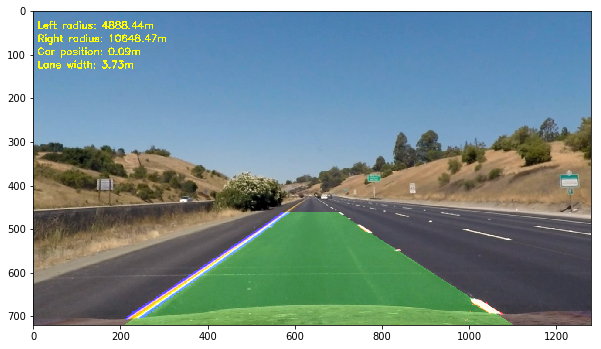

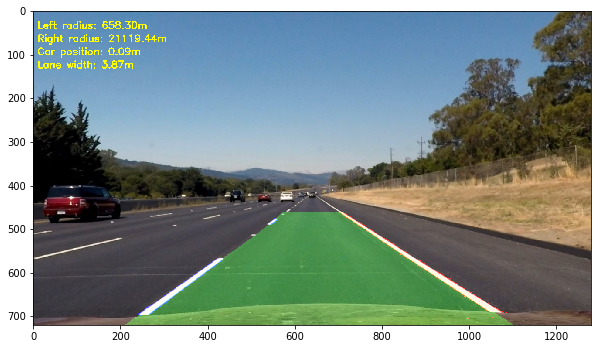

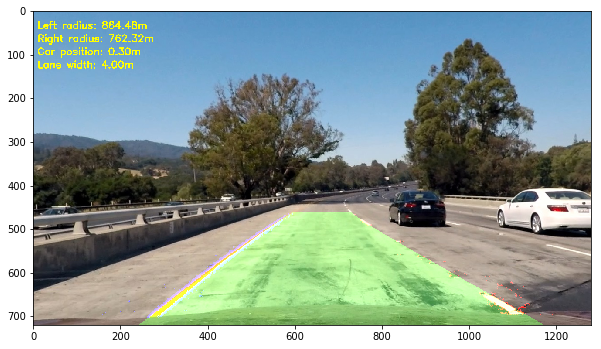

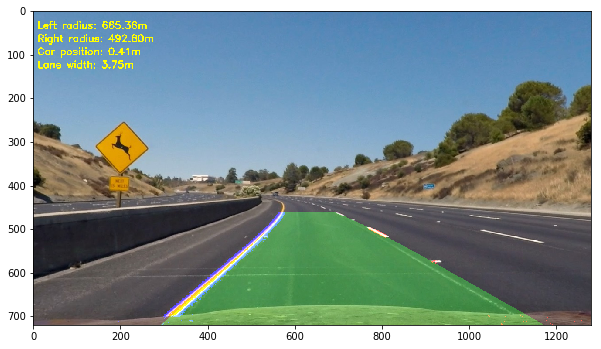

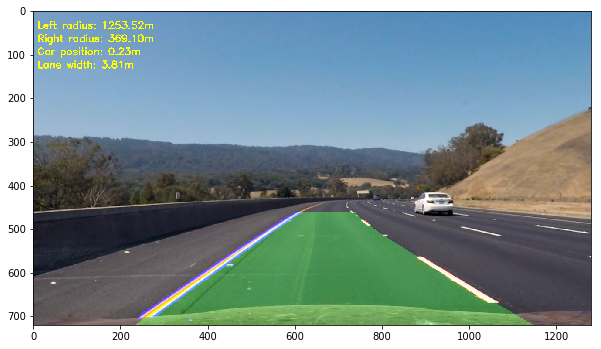

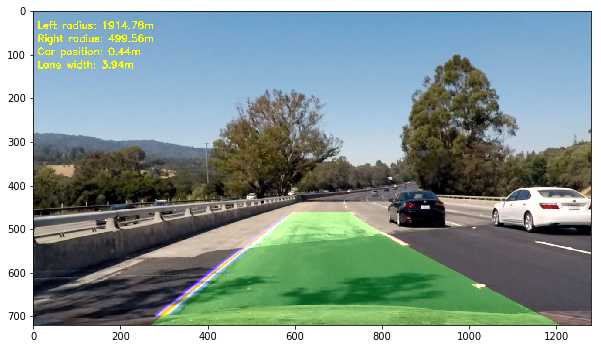

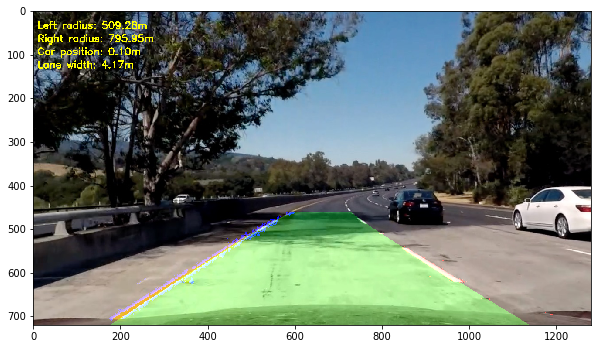

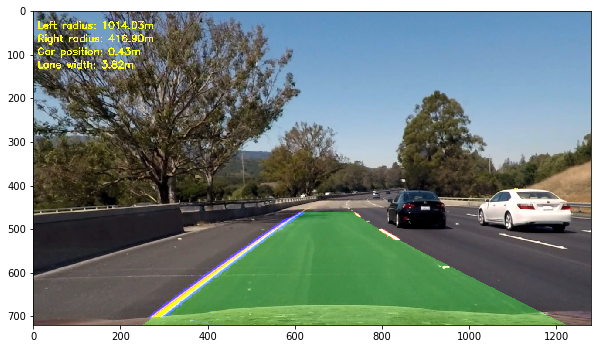

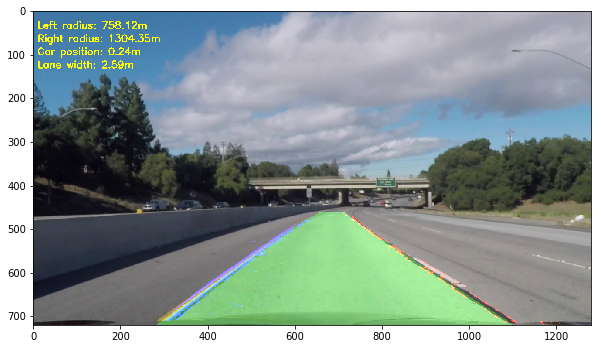

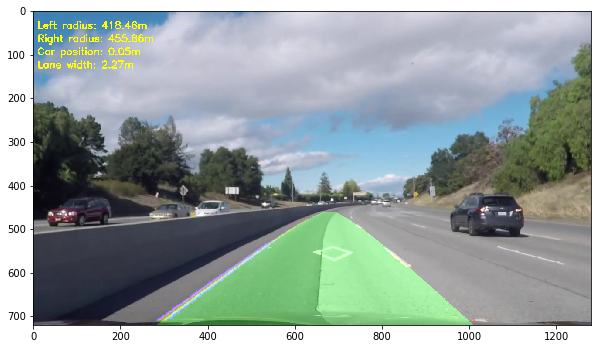

In [12]:
lastFrame = Lines()

for fname in test_images:
    img = cv2.imread(fname) 
    undistorted_image = cv2.undistort(img, mtx, dist, None, mtx)
    binary_image = thresholdImage(undistorted_image, show=False)
    warped_image = warper(binary_image)
    lastFrame.flg = False
    drawLineBoundaries(warped_image,lastFrame,False)
    lines_image = unwarper(lastFrame.out_img)
    undistorted_image = cv2.addWeighted(lines_image, 1, undistorted_image, 1, 0)
    result = addPoligonToImage(undistorted_image, lastFrame)
    #result = cv2.undistort(result, mtx, dist, None, mtx)
    result = addTextToImage(result, lastFrame.left_curverad, lastFrame.right_curverad, lastFrame.car_position, lastFrame.width_lane)
    
    result = result[:,:,::-1]
    plt.figure(figsize=(10,10))
    plt.imshow(result)



## Test video

In [16]:
from moviepy.editor import VideoFileClip

class LinesDetector(object):
    def __init__(self, mtx, dist):
        self.lastFrame = Lines()
        self.mtx = mtx
        self.dist = dist
      
    def pipeline(self, img):
        #self.lastFrame.flg = False
        img = img[:,:,::-1]
        undistorted_image = cv2.undistort(img, self.mtx, self.dist, None, self.mtx)
        binary_image = thresholdImage(undistorted_image, show=False)
        warped_image = warper(binary_image)
        drawLineBoundaries(warped_image, self.lastFrame, False)
        result = addPoligonToImage(undistorted_image, self.lastFrame)
        #result = cv2.undistort(result, mtx, dist, None, mtx)
        result = addTextToImage(result, self.lastFrame.left_curverad, self.lastFrame.right_curverad, self.lastFrame.car_position, self.lastFrame.width_lane)
        result = result[:,:,::-1]
        return result

In [18]:
detector1 = LinesDetector(mtx, dist)
project_output = 'project_video_output.mp4'
clip1 = VideoFileClip("project_video.mp4")
project_clip = clip1.fl_image(detector1.pipeline) 
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [04:19<00:00,  4.97it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

Wall time: 4min 20s


In [17]:
detector2 = LinesDetector(mtx, dist)
challenge_output = 'challenge_video_output.mp4'
clip2 = VideoFileClip("challenge_video.mp4")
challenge_clip = clip2.fl_image(detector2.pipeline) 
%time challenge_clip.write_videofile(challenge_output, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|████████████████████████████████████████████████████████████████████████████████| 485/485 [01:40<00:00,  5.15it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

Wall time: 1min 41s


In [28]:
detector3 = LinesDetector(mtx, dist)
harder_challenge_output = 'harder_challenge_video_output.mp4'
clip3 = VideoFileClip("harder_challenge_video.mp4")
harder_challenge_clip = clip3.fl_image(detector3.pipeline) 
%time harder_challenge_clip.write_videofile(harder_challenge_output, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1199/1200 [04:30<00:00,  4.12it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

Wall time: 4min 31s
